![logo](https://github.com/data-silence/newsrucom-dataset-eda/blob/master/logo.png?raw=True)

# Исследование корпуса новостных текстов издательства newsru.com

### 0. Общие выводы по результатам проведённого исследования

1. Было собрано более 608_000 русскоязычных новостей за двадцать один год.
2. Новости собирались асинхронно и записывались в базу данных PostgreSQL. Скрипт парсера выложен в этот же репозиторий с именем "newsrucom async.py"
3. Датасет не содержит пустых и дублирующихся данных, не поэтому не требовал особой дополнительной обработки. Проводилась только работа по генерацию вспомогательных столбцов, основанных на временном таймстепе.
4. Датасет содержит два разных типа категориальной разбивки, коррелирующей между собой. Нужно будет подумать, на каком из них строить классификатор, или как объединить эти категории, чтобы строить классификатор
5. Каждая новость имеет три представления: заголовок новости, резюме и её полное содержание. Среднее число символов в каждом представлении - 73, 245 и 2067 символов. При этом среднеквадратичное отклонение полной новости чудовищное почти во всех категориях: и статистически, и исходя из здравого смысла (затраты на обучение, сохранение баланса смысла новости и её полноты), классификатор буду строить из резюме новости.    
6. Проведен анализ количества новостей в зависимости от агрегаций в различных временных интервалах: в годах, месяцах, днях месяца и днях недели:
- Самый "новостной год" - 2008 (год финансового кризиса, смены президента). По этот год включительно присутствовала устойчивая динамика по увеличению новостей за год. С 2009 года вплоть до 2014 пошла выраженная тенденция на небольшое, но устойчивое снижение новостного потока. С 2015 по 2017 включительно падение новостного фона приобрело ещё более крутой характер. Но с 2018 год по 2021 случился просто катастрофический обвал присутствия издания newsru.com в освещении новостной повестки.
- В выходные новостей значимо меньше, чем в будние дни.
- Самый насыщенные новостной повесткой - вторая половина и, особенно, конец календарного месяца, кроме 31-го числа. 31-е, в силу его меньшей частнотости, - самый спокойный новостной период в месяце.
- Наиболее активный новостной период в году - сентябрь-октябрь. Также высокая концентрация наблюдается в конце года в декабре, а также в марте-апреле. Самый спокойный месяц года январь, что наверняка связано с высоким количеством праздников (увидим дальше) и психологическим эффектом после завершения отчетного периода (надо бы сравнить с американскими СМИ, где календарный период завершается в марте.
- Проведен анализ количества новостей по дням года (пара день-месяц). Top-27 самых слабых дней по новостям полностью совпадают с календарными праздниками в РФ :-)) Самые насыщенные у россиян дни на новости - 16 октября и 26 сентября. Вообще, последний квартал самый "новостной", что понятно.    
По итогам работы с временными интервалами пришёл к выводу, что данные нужно анализировать в хронологическом порядке, а не в порядке возрастания исследуемой величины, потому как именно так видны верные тенденции, и можно делать корректные выводы по результатам их наблюдения.
7. Была составлена карта тэгов в разрезе каждой категории за шесть определяющих лет (по моему мнению). Сделал для себя много выводов, но озвучивать не буду.
8. Собранный датасет признан очень подходящим для решения задач классификации и суммаризации текстов, чем планирую заняться.

## 1. Об источнике

* Сбор данных проводился с сайта newsru.com, который содержит русскоязычные новости за 21 год с августа 2000 по май 2021 года.
* Сайт работает как архив, поэтому не препятствует парсингу данных 
* Все новости доступны к свободному использованию в рамках лицензии Creative Commons Attribution 4.0 International license

## 2. Реализация парсера

* Парсер реализован в виде python-скрипта, который находится в этом же репозитории под именем "newsrucom async.py"
* Реализован асинхронный сбор новостей, которые записавались в удаленную базу данных postgresql на сервере.
* На этапе анализа данных осуществлялась выгрузка собранной информации в формат pandas dataframe

## 3. Анализ данных

### 3.1 Загрузка и установка библиотек, настойка параметров

In [4]:
import os
from dotenv import load_dotenv
from sqlalchemy import create_engine

In [255]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import datetime
from wordcloud import WordCloud, STOPWORDS

import nltk
from nltk.corpus import stopwords
nltk.download("stopwords")

sns.set(style="darkgrid")
%matplotlib inline

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\maxle\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.


### 3.2. Загрузка датасета

In [18]:
DB_TM = os.getenv("DB_TM")
DB_USER = os.getenv("DB_USER")
DB_PASS = os.getenv("DB_PASS")
DB_HOST = os.getenv("DB_HOST")


newsrucom_engine = create_engine(
    f'postgresql+psycopg2://{DB_USER}:{DB_PASS}@{DB_HOST}/{DB_TM}', pool_pre_ping=True)

In [20]:
df = pd.read_sql("SELECT url, category, title, resume, news, date FROM news WHERE agency = 'newsru.com'", con=newsrucom_engine)

In [269]:
df.to_pickle('df.p', compression='gzip')

### 3.3. Оценка параметров датасета (размеры, дубликаты, пропуски)

In [23]:
df.shape

(608028, 6)

In [24]:
df.head()

,url,category,title,resume,news,date
0,https://newsru.com/finance/14sep2000/rts1.html,economy,Российский рынок акций закрылся выше уровня от...,"Аналитики считают, что следующая сессия должна...","К 18:00 сводный индекс РТС, как и предсказывал...",2000-09-14 19:07:00
1,https://newsru.com/russia/24nov2001/pr_smi.html,society,"Редакция чеченской газеты ""Маршо"" выпускает из...",В типографии нет ни одного компьютера. На отли...,Жилой дом в центре Урус-Мартана. Во дворе типо...,2001-11-24 19:27:00
2,https://newsru.com/cinema/19oct2009/elvis.html,entertainment,В США распродали личные вещи Элвиса. Прядь вол...,Накануне в Чикаго ушли с молока около 200 личн...,Накануне в Чикаго прошла распродажа личных вещ...,2009-10-19 12:19:00
3,https://newsru.com/finance/19jun2007/furs.html,economy,Евросоюз отказывается от меха кошек и собак,Европарламент наложил запрет на торговлю одежд...,Чудовищная торговля мехом котов и собак оказал...,2007-06-19 15:16:00
4,https://newsru.com/cinema/19jun2007/jones.html,entertainment,Спилберг и Лукас превратили Нью-Мексико в Марокко,"В США начались съемки четвертой части фильма ""...","В США начались съемки четвертой части фильма ""...",2007-06-19 15:15:00


In [1]:
df['tags'] = df['url'].apply(lambda x: x.split('/')[3]) # создаём поле с тэгами, которые вычленяем из адреса страницы

NameError: name 'df' is not defined

In [39]:
df.shape

(608028, 7)

In [40]:
df.tags.value_counts()

world      180612
russia     180284
sport       77344
finance     57753
cinema      39744
auto        25209
realty      23714
hitech      23368
Name: tags, dtype: int64

In [41]:
df.category.value_counts()

society          384610
sports            77344
economy           57753
technology        48577
entertainment     39744
Name: category, dtype: int64

In [209]:
df.describe().T.style.background_gradient(subset=['mean', '50%', 'min'], cmap='coolwarm')

,count,mean,std,min,25%,50%,75%,max
day,608028.000000,15.963868,8.721858,1.000000,9.000000,16.000000,23.000000,31.000000
year,608028.000000,2009.935710,5.464055,2000.000000,2006.000000,2010.000000,2014.000000,2021.000000
month,608028.000000,6.615939,3.445051,1.000000,4.000000,7.000000,10.000000,12.000000


In [44]:
df.isna().sum()

url         0
category    0
title       0
resume      0
news        0
date        0
tags        0
dtype: int64

In [46]:
df.duplicated()

0         False
1         False
2         False
3         False
4         False
          ...  
608023    False
608024    False
608025    False
608026    False
608027    False
Length: 608028, dtype: bool

### 3.4. Создание новых временных признаков на основе даты и их анализ на основе построения графиков

In [61]:
df['day'] = df['date'].dt.day

In [65]:
df['month_year'] = df['date'].dt.to_period('M')

In [66]:
df['year'] = df['date'].dt.year

In [67]:
df['month'] = df['date'].dt.month

In [68]:
df.head()

,url,category,title,resume,news,date,tags,day,month_year,year,month
0,https://newsru.com/finance/14sep2000/rts1.html,economy,Российский рынок акций закрылся выше уровня от...,"Аналитики считают, что следующая сессия должна...","К 18:00 сводный индекс РТС, как и предсказывал...",2000-09-14 19:07:00,finance,14,2000-09,2000,9
1,https://newsru.com/russia/24nov2001/pr_smi.html,society,"Редакция чеченской газеты ""Маршо"" выпускает из...",В типографии нет ни одного компьютера. На отли...,Жилой дом в центре Урус-Мартана. Во дворе типо...,2001-11-24 19:27:00,russia,24,2001-11,2001,11
2,https://newsru.com/cinema/19oct2009/elvis.html,entertainment,В США распродали личные вещи Элвиса. Прядь вол...,Накануне в Чикаго ушли с молока около 200 личн...,Накануне в Чикаго прошла распродажа личных вещ...,2009-10-19 12:19:00,cinema,19,2009-10,2009,10
3,https://newsru.com/finance/19jun2007/furs.html,economy,Евросоюз отказывается от меха кошек и собак,Европарламент наложил запрет на торговлю одежд...,Чудовищная торговля мехом котов и собак оказал...,2007-06-19 15:16:00,finance,19,2007-06,2007,6
4,https://newsru.com/cinema/19jun2007/jones.html,entertainment,Спилберг и Лукас превратили Нью-Мексико в Марокко,"В США начались съемки четвертой части фильма ""...","В США начались съемки четвертой части фильма ""...",2007-06-19 15:15:00,cinema,19,2007-06,2007,6


In [76]:
df[['month', 'day', 'news']].groupby(['month', 'day']).count()

news
month day      
1     1     575
      2     715
      3     829
      4     926
      5     900
...         ...
12    27   1630
      28   1662
      29   1680
      30   1495
      31   1095

[366 rows x 1 columns]

In [79]:
grouped = df[['month', 'day', 'news']].groupby(['month', 'day']).count().reset_index()
grouped.sort_values('news', ascending=False)
# grouped

,month,day,news
289,10,16,1947
269,9,26,1922
261,9,18,1914
317,11,13,1899
297,10,24,1896
...,...,...,...
2,1,3,829
6,1,7,797
1,1,2,715
0,1,1,575


In [218]:
sorted_month_day = grouped.sort_values(['month', 'day'], ascending=True)

In [222]:
sorted_month_day.drop(columns='month-day', inplace=True)

In [228]:
sorted_month_day['month_day'] = sorted_month_day.apply(lambda x: str(x[0]) + '-' + str(x[1]), axis=1)

In [229]:
sorted_month_day

,month,day,news,month_day
0,1,1,575,1-1
1,1,2,715,1-2
2,1,3,829,1-3
3,1,4,926,1-4
4,1,5,900,1-5
...,...,...,...,...
361,12,27,1630,12-27
362,12,28,1662,12-28
363,12,29,1680,12-29
364,12,30,1495,12-30


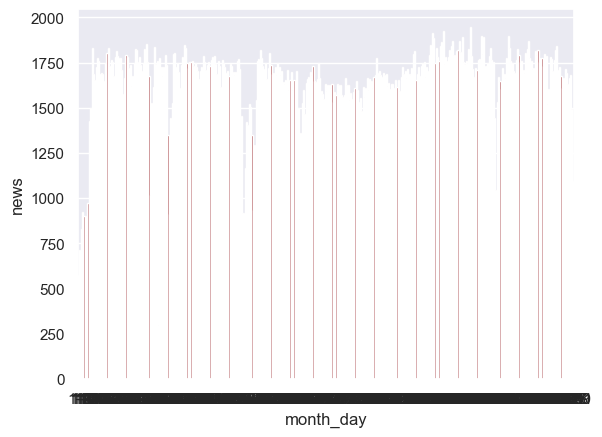

In [231]:
sns.barplot(x=sorted_month_day.month_day, y=sorted_month_day.news, color='r');

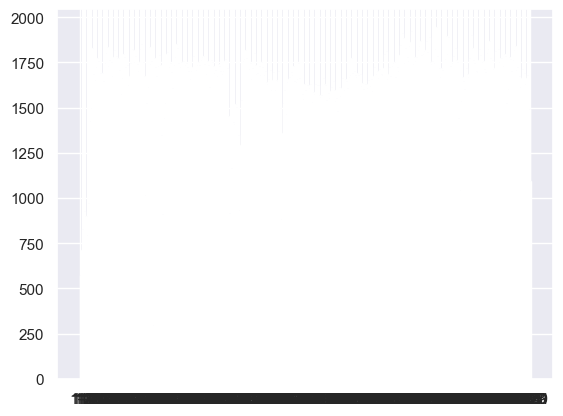

In [235]:
plt.bar(x=sorted_month_day.month_day, height=sorted_month_day.news);

In [207]:
grouped.sort_values('news', ascending=True).head(27)

,month,day,news
59,2,29,297
0,1,1,575
1,1,2,715
6,1,7,797
2,1,3,829
163,6,12,886
4,1,5,900
5,1,6,902
67,3,8,910
121,5,1,917


In [91]:
month_news = grouped[['month', 'news']].groupby(['month']).agg(count_news=('news', 'sum'))
month_news

,count_news
month,
1,46156
2,48076
3,52226
4,51634
5,48493
6,48023
7,49385
8,51507
9,53000


In [211]:
grouped.nlargest(10, 'news')

,month,day,news
289,10,16,1947
269,9,26,1922
261,9,18,1914
317,11,13,1899
297,10,24,1896
283,10,10,1893
299,10,26,1892
262,9,19,1885
332,11,28,1870
276,10,3,1868


In [213]:
grouped.nsmallest(27, 'news')

,month,day,news
59,2,29,297
0,1,1,575
1,1,2,715
6,1,7,797
2,1,3,829
163,6,12,886
4,1,5,900
5,1,6,902
67,3,8,910
121,5,1,917


Очень смешно: первые 27 наименьших значений полностью соответствуют календарю праздников в РФ (за исключением даты-лидера - 29-го февраля, который является редкой датой по очень понятной причине :-) 

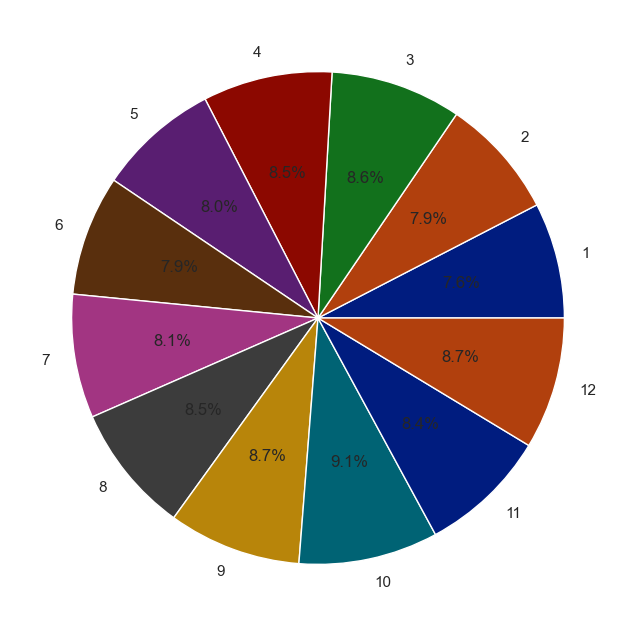

In [177]:
palette_color = sns.color_palette('bright')
palette_color = sns.color_palette('dark')
plt.figure(figsize=[8,8])
plt.pie(month_news.count_news, labels=month_news.index, colors=palette_color, autopct='%.1f%%');

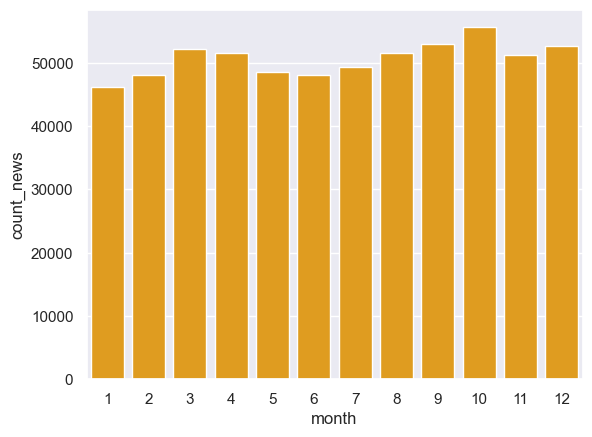

In [185]:
sns.barplot(y=month_news.count_news, x=month_news.index, color='orange');

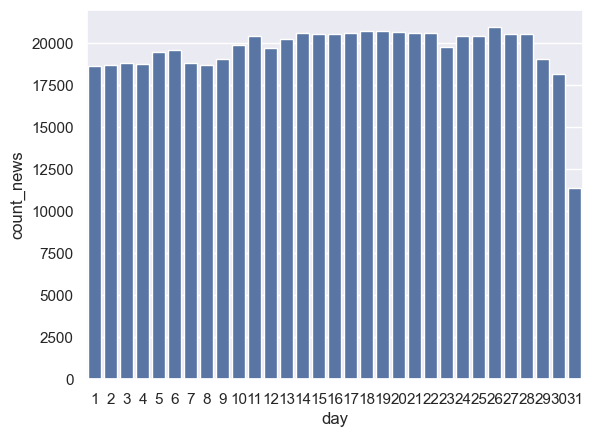

In [170]:
day_news = grouped[['day', 'news']].groupby(['day']).agg(count_news=('news', 'sum')).reset_index()
sns.barplot(x=day_news.day, y=day_news.count_news);

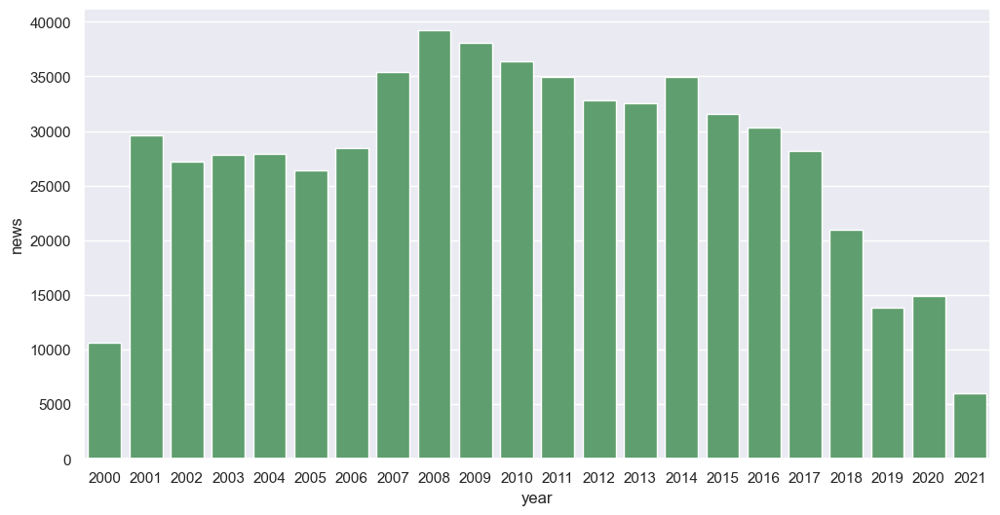

In [189]:
year_news = df[['year', 'news']].groupby(['year']).count().reset_index()
plt.figure(figsize=[12,6])
sns.barplot(x=year_news.year, y=year_news.news, color='g');

C:\Users\maxle\AppData\Local\Temp\ipykernel_2796\965637973.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=df['weekday'], palette='tab10', order=df['weekday'].value_counts(ascending=True).index);


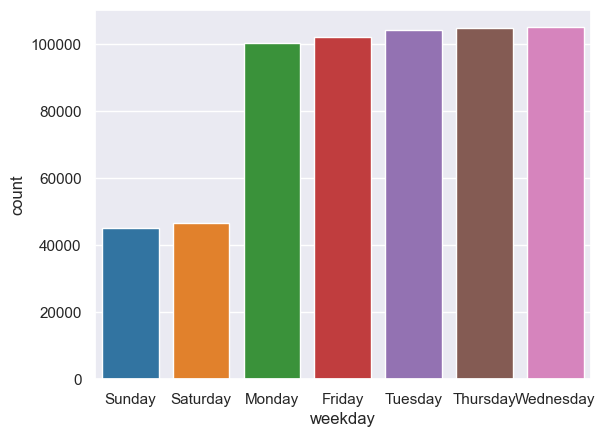

In [249]:
df['weekday'] = df['date'].dt.strftime('%A')
# fig, axs = plt.subplots(1, figsize=(20, 12), dpi=200)
sns.countplot(x=df['weekday'], palette='tab10', order=df['weekday'].value_counts(ascending=True).index);
# sns.set_title('Count news by datetime');

А теперь пробуем способы работы с временными данными, которые предложены в эталанном ноутбуке:

In [251]:
df['month'] = df['date'].dt.strftime("%B")
df.head()

,url,category,title,resume,news,date,tags,day,month_year,year,month,weekday
0,https://newsru.com/finance/14sep2000/rts1.html,economy,Российский рынок акций закрылся выше уровня от...,"Аналитики считают, что следующая сессия должна...","К 18:00 сводный индекс РТС, как и предсказывал...",2000-09-14 19:07:00,finance,14,2000-09,2000,September,Thursday
1,https://newsru.com/russia/24nov2001/pr_smi.html,society,"Редакция чеченской газеты ""Маршо"" выпускает из...",В типографии нет ни одного компьютера. На отли...,Жилой дом в центре Урус-Мартана. Во дворе типо...,2001-11-24 19:27:00,russia,24,2001-11,2001,November,Saturday
2,https://newsru.com/cinema/19oct2009/elvis.html,entertainment,В США распродали личные вещи Элвиса. Прядь вол...,Накануне в Чикаго ушли с молока около 200 личн...,Накануне в Чикаго прошла распродажа личных вещ...,2009-10-19 12:19:00,cinema,19,2009-10,2009,October,Monday
3,https://newsru.com/finance/19jun2007/furs.html,economy,Евросоюз отказывается от меха кошек и собак,Европарламент наложил запрет на торговлю одежд...,Чудовищная торговля мехом котов и собак оказал...,2007-06-19 15:16:00,finance,19,2007-06,2007,June,Tuesday
4,https://newsru.com/cinema/19jun2007/jones.html,entertainment,Спилберг и Лукас превратили Нью-Мексико в Марокко,"В США начались съемки четвертой части фильма ""...","В США начались съемки четвертой части фильма ""...",2007-06-19 15:15:00,cinema,19,2007-06,2007,June,Tuesday


In [252]:
df.columns

Index(['url', 'category', 'title', 'resume', 'news', 'date', 'tags', 'day',
       'month_year', 'year', 'month', 'weekday'],
      dtype='object')

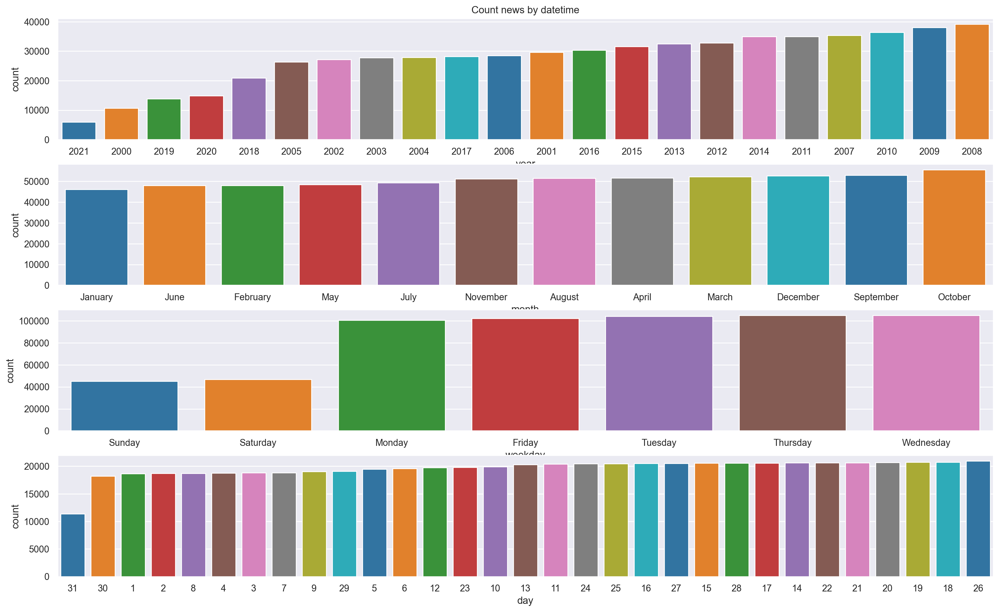

In [263]:
fig, axs = plt.subplots(4, 1, figsize=(20, 12), dpi=200)
for ind, col in enumerate(['year', 'month', 'weekday', 'day']):
    sns.countplot(x=df[col], palette='tab10', ax=axs[ind], order=df[col].value_counts(ascending=True).index)
axs[0].set_title('Count news by datetime');

Мне хорошо видно, что анализ временных данных в случае упорядочивания по убыванию целевых значений, гораздо менее нагляден, чем при упорядочивании в хронологическом порядке, как это делал я в первой части

### 3.5. Анализ длительности представлений новости и их статистических характеристик 

In [264]:
df['len_title'] = df['title'].str.len()
df['len_resume'] = df['resume'].str.len()
df['len_news'] = df['news'].str.len()

In [298]:
df[['len_title', 'len_resume', 'len_news']].describe()

,len_title,len_resume,len_news
count,608028.000000,608028.000000,608028.000000
mean,73.152692,245.428637,2068.874098
std,19.653280,59.891592,2108.895221
min,11.000000,0.000000,1.000000
25%,59.000000,209.000000,796.000000
50%,72.000000,247.000000,1642.000000
75%,86.000000,290.000000,2730.000000
max,201.000000,575.000000,314187.000000


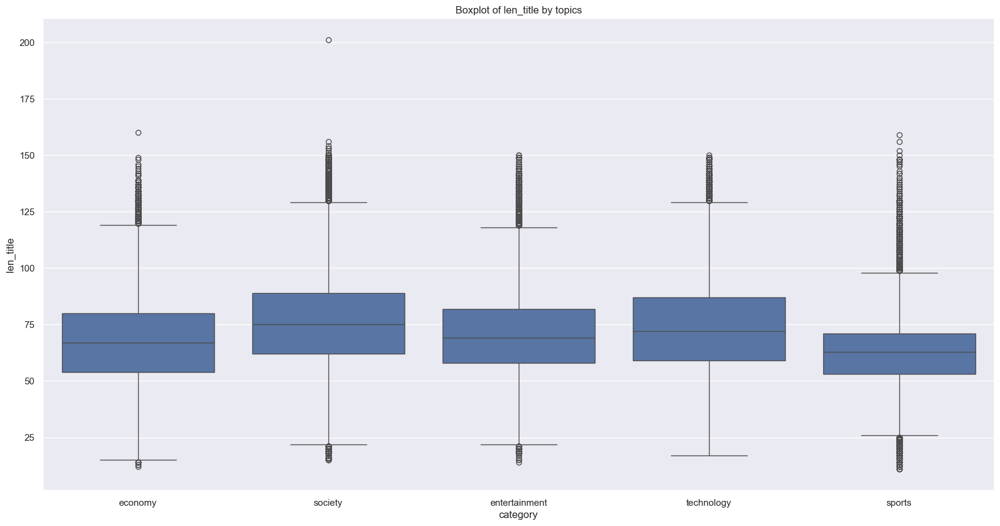

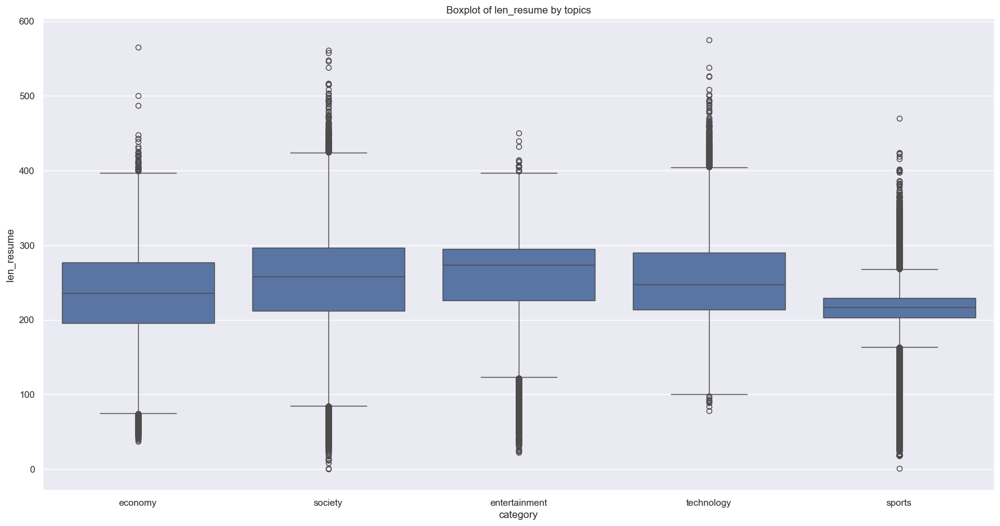

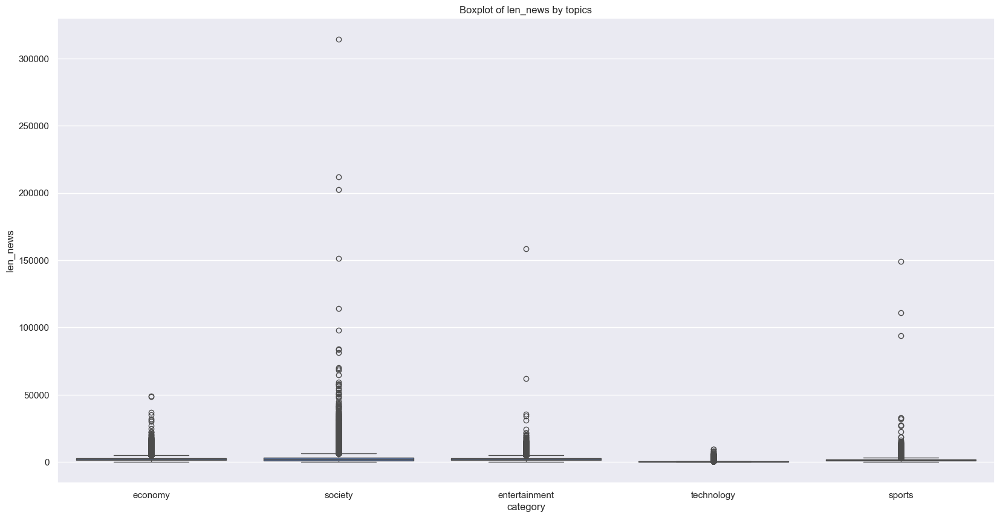

In [266]:
for col in ['len_title', 'len_resume', 'len_news']:
    fig, ax = plt.subplots(1, 1, figsize=(20, 10), dpi=100)
    sns.boxplot(x="category", y=col, data=df, ax=ax)
    plt.title(f'Boxplot of {col} by topics');

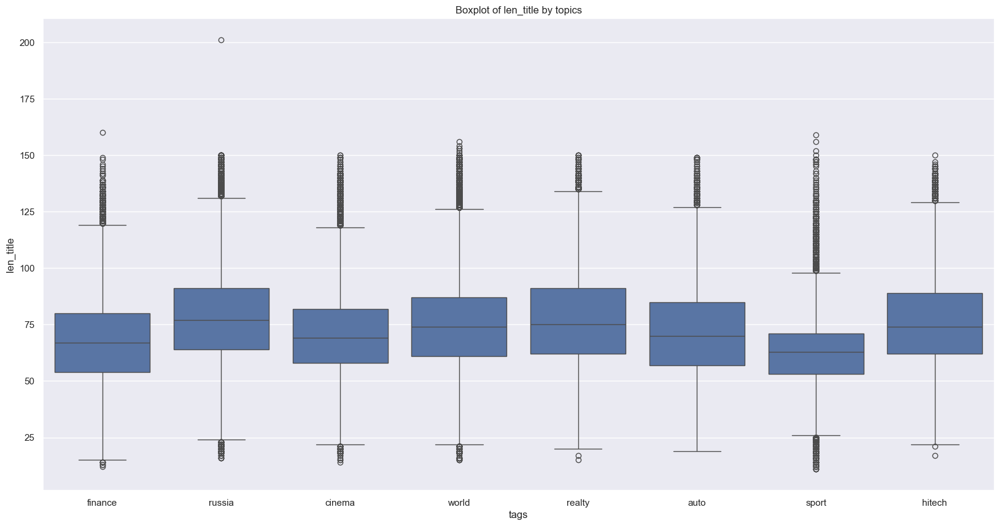

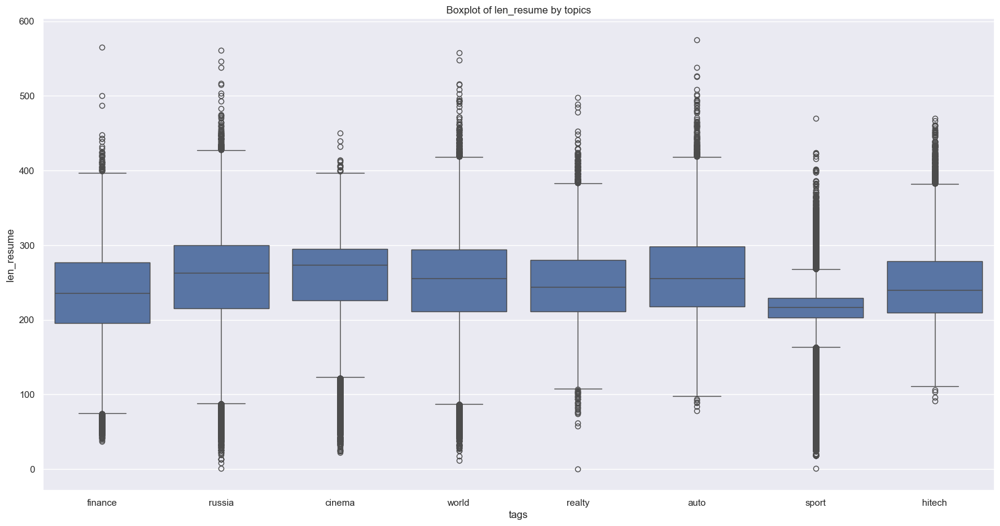

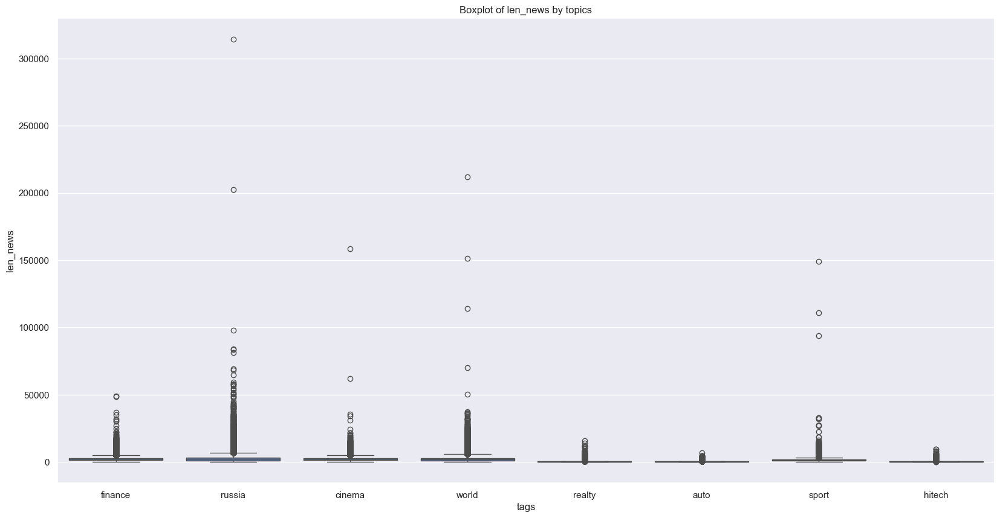

In [267]:
for col in ['len_title', 'len_resume', 'len_news']:
    fig, ax = plt.subplots(1, 1, figsize=(20, 10), dpi=100)
    sns.boxplot(x="tags", y=col, data=df, ax=ax)
    plt.title(f'Boxplot of {col} by topics');

### 3.6. Облако тэгов в разрезе категорий

In [275]:
stop_words = stopwords.words('russian')
stop_words.extend(['что', 'это', 'так',
                    'вот', 'быть', 'как',
                    'в', '—', 'к', 'за', 'из', 'из-за',
                    'на', 'ок', 'кстати',
                    'который', 'мочь', 'весь',
                    'еще', 'также', 'свой',
                    'ещё', 'самый', 'ул', 'комментарий',
                    'английский', 'язык', 'года', 'году'])

C:\Users\maxle\AppData\Local\Temp\ipykernel_2796\4264230998.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, 1, figsize=(20, 10))


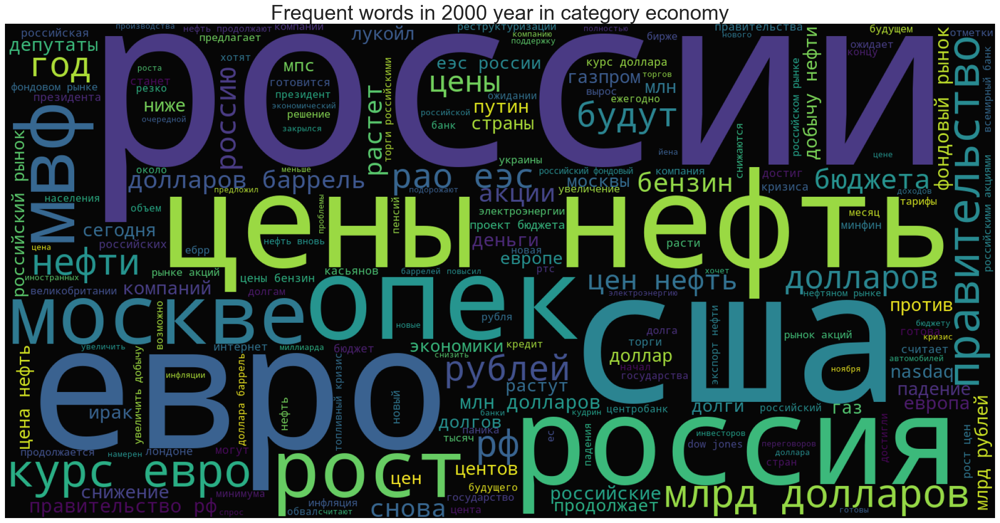

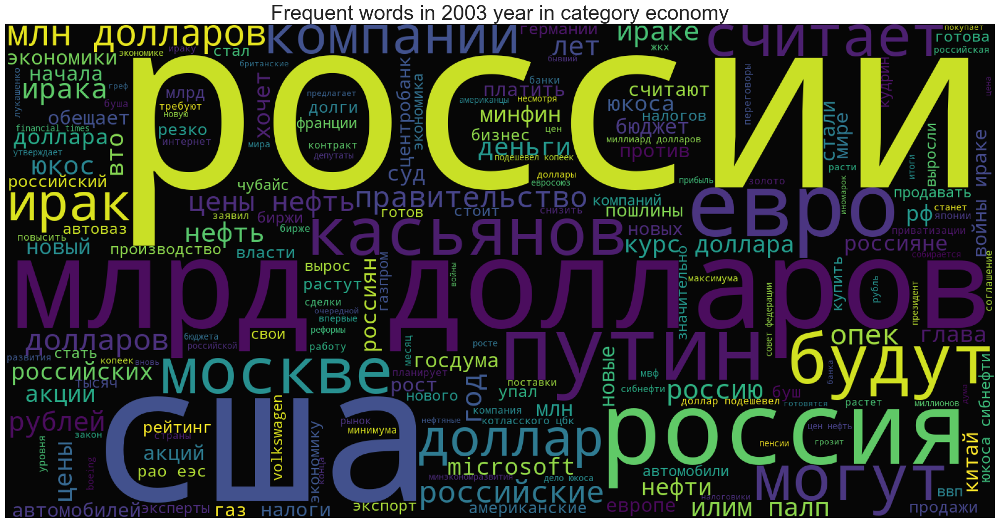

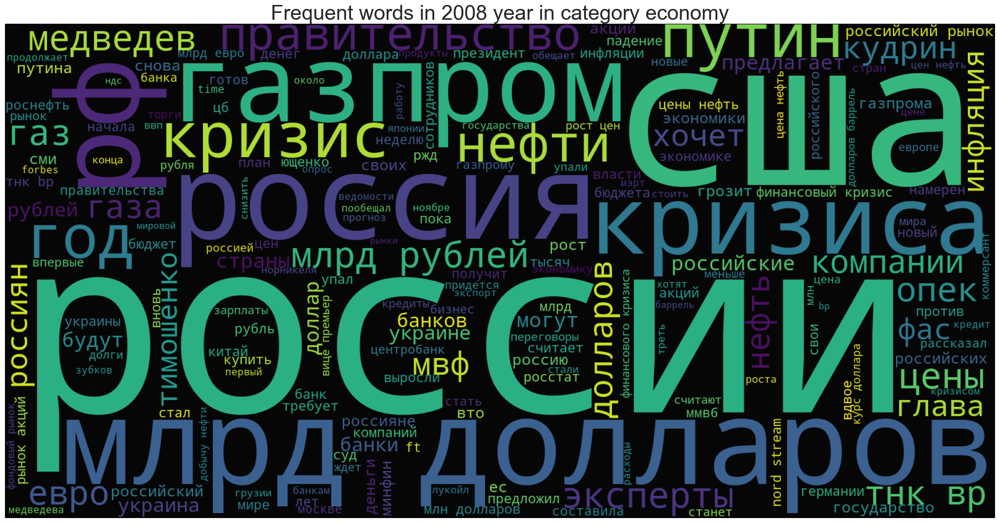

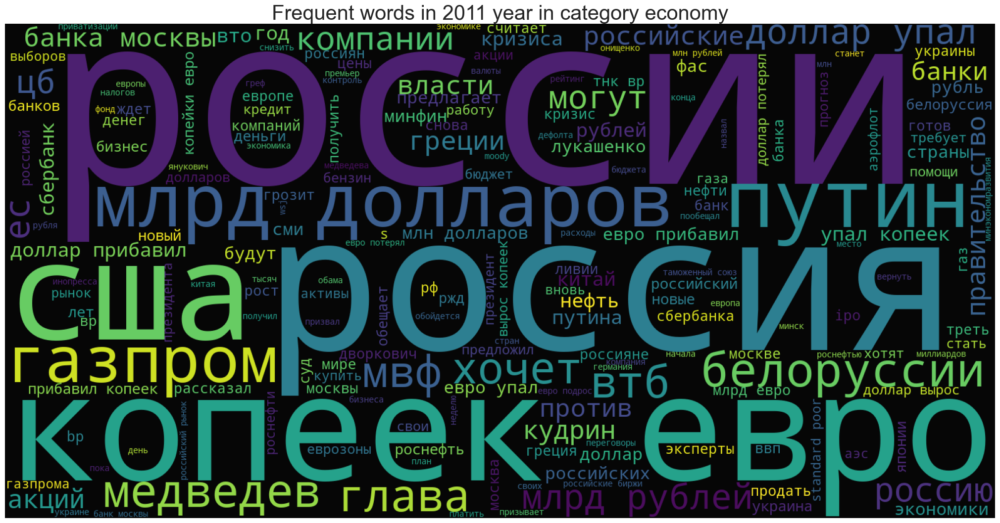

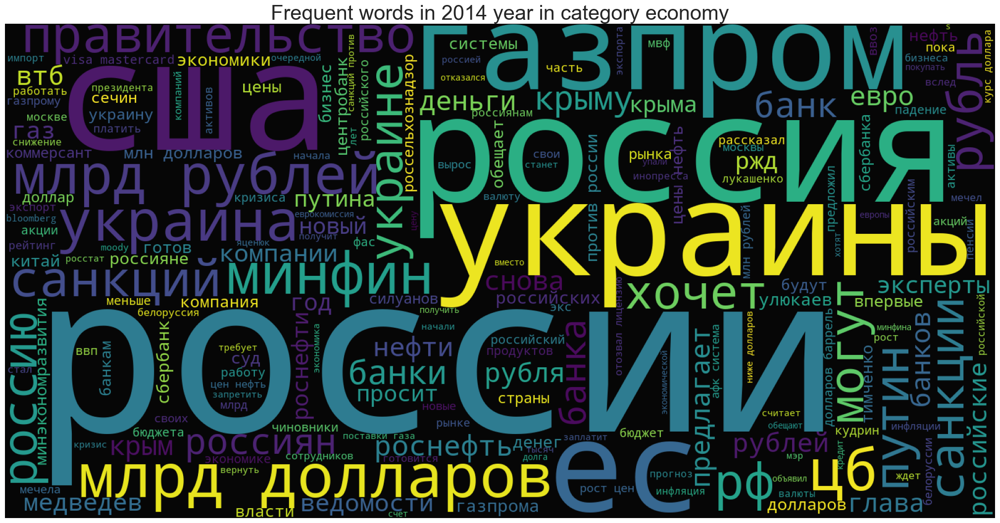

...

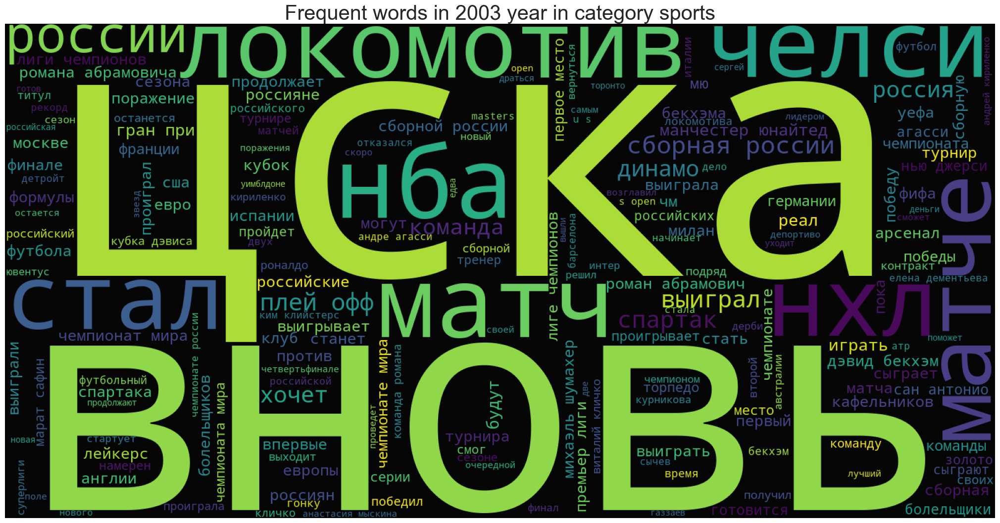

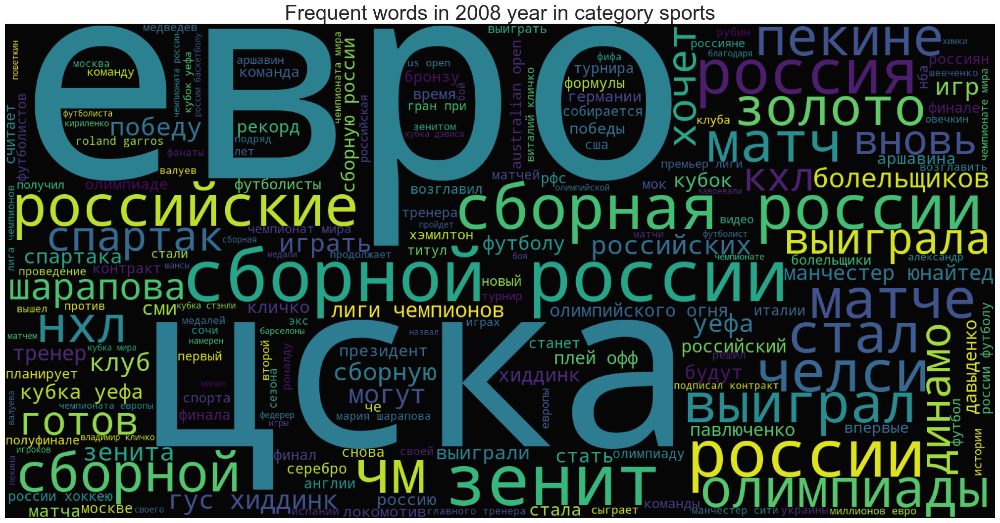

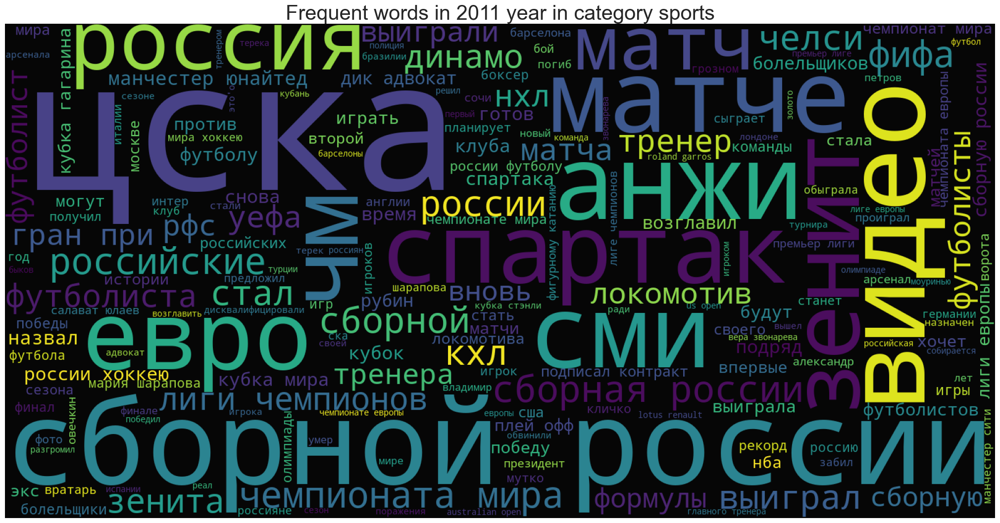

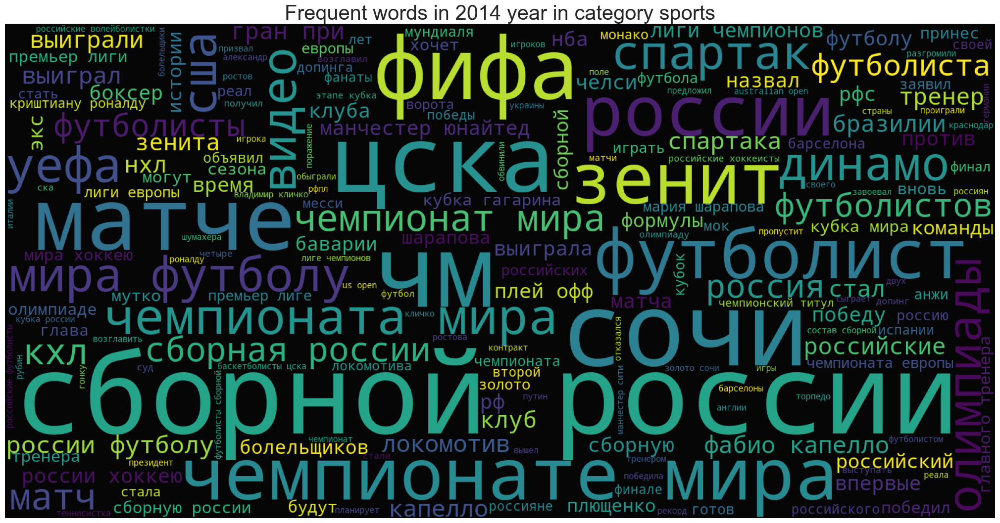

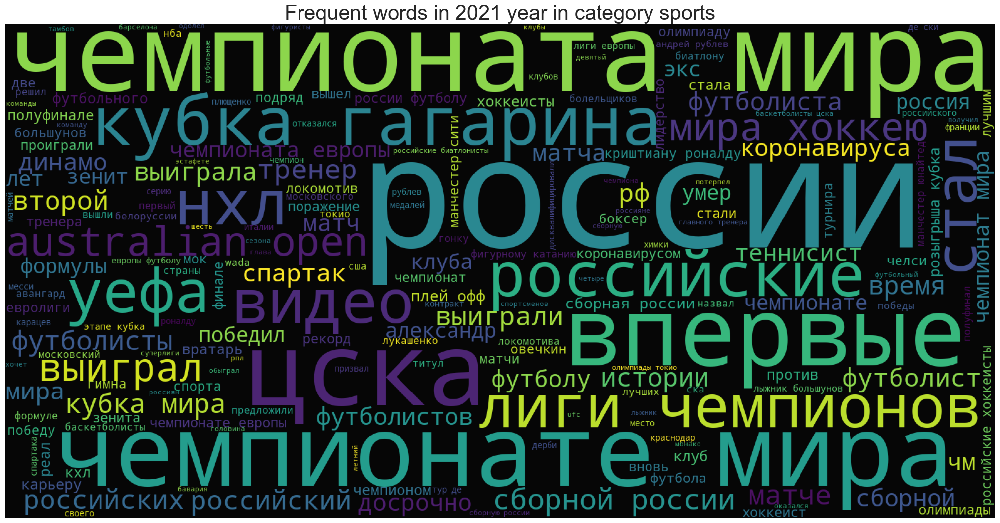

In [296]:
for category in df.category.unique():
    for year in (2000, 2003, 2008, 2011, 2014, 2021):
    # for year in sorted(df.year.unique()):
        temp_df = df[(df.year == year)&(df.category == category)]
        if not temp_df.empty:
            words = temp_df.title.str.split(' ').explode().values
            words = [word.lower() for word in words if word.lower() not in stop_words]
        
            wc = WordCloud(background_color="black", width=1600, height=800)
            wc.generate(" ".join(words))
        
            fig, ax = plt.subplots(1, 1, figsize=(20, 10))
            plt.axis("off")
            plt.tight_layout(pad=0)
            ax.set_title(f"Frequent words in {year} year in category {category}", fontsize=30)
            ax.imshow(wc, alpha=0.98)

Выводы оставляются вдумчивому читателю